In [18]:
!pip install pandas networkx matplotlib geopandas shapely
!pip install mplleaflet
!pip install folium


In [ ]:
import pandas as pd

nodes_df = pd.read_csv('nodes.csv')
edges_df = pd.read_csv('edges_selected_with_id.csv')

nodes_df.columns = [col.split(',')[0] for col in nodes_df.columns]

print(nodes_df.head())
print(nodes_df.columns)

print(edges_df.head())
print(edges_df.columns)


       osmid          y          x  street_cou highway  ref
0  255015605 -16.392800 -71.538259           3     NaN  NaN
1  255015612 -16.395886 -71.539761           4     NaN  NaN
2  255015619 -16.394308 -71.539031           3     NaN  NaN
3  255015622 -16.392488 -71.540206           3     NaN  NaN
4  255015624 -16.392256 -71.540604           5     NaN  NaN
Index(['osmid', 'y', 'x', 'street_cou', 'highway', 'ref'], dtype='object')
   id          u           v  key       osmid   length                  name
0   1  255015605  1284479744    0   200029175   37.701                   NaN
1   2  255015605  1284479766    0   403167399  105.992  Avenida de la Marina
2   3  255015605  1284479773    0  1276425076   43.085  Avenida de la Marina
3   4  255015612  1284479835    0   200028847   28.289           Calle Moral
4   5  255015612   255015626    0  1270954406   16.649  Avenida de la Marina
Index(['id', 'u', 'v', 'key', 'osmid', 'length', 'name'], dtype='object')


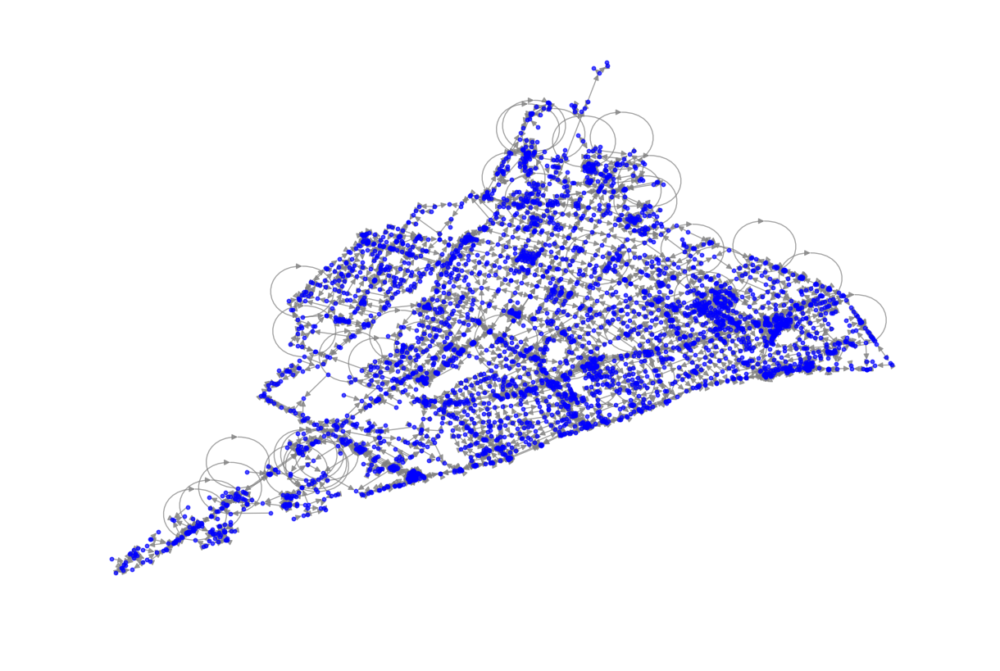

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt

G = nx.DiGraph()

for index, row in nodes_df.iterrows():
    G.add_node(row['osmid'], pos=(row['x'], row['y']))


for index, row in edges_df.iterrows():
    G.add_edge(row['u'], row['v'], length=row['length'])

def draw_graph(G, edge_color_map, new_node=None, focus_nodes=None):
    pos = nx.get_node_attributes(G, 'pos')
    edge_colors = [edge_color_map.get((u, v), 'gray') for u, v in G.edges()]

    plt.figure(figsize=(12, 8))
    nx.draw(G, pos, with_labels=False, node_size=10, node_color='blue', edge_color=edge_colors, alpha=0.7)

    if new_node:
        nx.draw_networkx_nodes(G, pos, nodelist=[new_node['osmid']], node_color='green', node_size=50)

    if focus_nodes:
        focus_pos = {node: pos[node] for node in focus_nodes if node in pos}
        if focus_pos:
            x_vals = [x for x, y in focus_pos.values()]
            y_vals = [y for x, y in focus_pos.values()]
            plt.xlim(min(x_vals) - 0.01, max(x_vals) + 0.01)
            plt.ylim(min(y_vals) - 0.01, max(y_vals) + 0.01)

    plt.show()

edge_color_map = {}
draw_graph(G, edge_color_map)


In [20]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import folium
from folium import plugins

# Leer los archivos CSV
nodes_df = pd.read_csv('nodes.csv')
edges_df = pd.read_csv('edges_selected_with_id.csv')

# Limpiar los nombres de las columnas de nodes_df
nodes_df.columns = [col.split(',')[0] for col in nodes_df.columns]

# Crear un grafo dirigido
G = nx.DiGraph()

# Añadir los nodos
for index, row in nodes_df.iterrows():
    G.add_node(row['osmid'], pos=(row['x'], row['y']))

# Añadir las aristas
for index, row in edges_df.iterrows():
    G.add_edge(row['u'], row['v'], length=row['length'])

# Función para dibujar el grafo
def draw_graph(G, edge_color_map, new_node=None, focus_nodes=None):
    pos = nx.get_node_attributes(G, 'pos')

    # Crear el mapa
    m = folium.Map(location=[-16.4, -71.54], zoom_start=15)

    # Añadir las aristas al mapa
    for u, v in G.edges():
        points = [(pos[u][1], pos[u][0]), (pos[v][1], pos[v][0])]
        color = edge_color_map.get((u, v), 'gray')
        folium.PolyLine(points, color=color, weight=2.5, opacity=0.8).add_to(m)

    # Añadir los nodos al mapa
    for node, (x, y) in pos.items():
        folium.CircleMarker(location=(y, x), radius=2, color='blue', fill=True).add_to(m)

    if new_node:
        folium.CircleMarker(location=(new_node['y'], new_node['x']), radius=5, color='lightgreen', fill=True).add_to(m)

    if focus_nodes:
        focus_pos = {node: pos[node] for node in focus_nodes if node in pos}
        if focus_pos:
            x_vals = [x for x, y in focus_pos.values()]
            y_vals = [y for x, y in focus_pos.values()]
            bounds = [[min(y_vals) - 0.001, min(x_vals) - 0.001], [max(y_vals) + 0.001, max(x_vals) + 0.001]]
            m.fit_bounds(bounds)

    # Guardar el mapa en un archivo HTML y mostrarlo
    m.save('map.html')
    return m

# Dibujar el grafo inicial
edge_color_map = {}
m = draw_graph(G, edge_color_map)

# Mostrar el mapa en una celda de Jupyter Notebook
m


In [36]:
import pandas as pd
import networkx as nx
import folium

# Leer los archivos CSV
nodes_df = pd.read_csv('nodes.csv')
edges_df = pd.read_csv('edges_selected_with_id.csv')

# Limpiar los nombres de las columnas de nodes_df
nodes_df.columns = [col.split(',')[0] for col in nodes_df.columns]

# Crear un grafo dirigido
G = nx.DiGraph()

# Añadir los nodos
for index, row in nodes_df.iterrows():
    G.add_node(row['osmid'], pos=(row['x'], row['y']))

# Añadir las aristas
for index, row in edges_df.iterrows():
    G.add_edge(row['u'], row['v'], length=row['length'])

# Función para dibujar el grafo
def draw_graph(G, edge_color_map, new_node=None, focus_nodes=None):
    pos = nx.get_node_attributes(G, 'pos')

    # Crear el mapa
    m = folium.Map(location=[-16.4, -71.54], zoom_start=15)

    # Añadir las aristas al mapa
    for u, v in G.edges():
        points = [(pos[u][1], pos[u][0]), (pos[v][1], pos[v][0])]
        color = edge_color_map.get((u, v), 'gray')
        folium.PolyLine(points, color=color, weight=2.5, opacity=0.8).add_to(m)

    # Añadir los nodos al mapa
    for node, (x, y) in pos.items():
        folium.CircleMarker(location=(y, x), radius=2, color='blue', fill=True).add_to(m)

    if new_node:
        folium.CircleMarker(location=(new_node['y'], new_node['x']), radius=5, color='lightgreen', fill=True).add_to(m)

    if focus_nodes:
        focus_pos = {node: pos[node] for node in focus_nodes if node in pos}
        if focus_pos:
            x_vals = [x for x, y in focus_pos.values()]
            y_vals = [y for x, y in focus_pos.values()]
            bounds = [[min(y_vals) - 0.001, min(x_vals) - 0.001], [max(y_vals) + 0.001, max(x_vals) + 0.001]]
            m.fit_bounds(bounds)

    #folium.CircleMarker(location=(-16.397883382286324, -71.5361070326179), radius=2, color='gree', fill=True).add_to(m)

    m.save('map.html')
    return m

# Suponiendo que tenemos los datos
edge_id = 314  # Reemplaza con el ID proporcionado
new_node = {'osmid': 999999, 'x': -16.397883382286324, 'y': -71.53610703261799}

# Obtener la arista con el ID especificado
edge_row = edges_df.loc[edges_df['id'] == edge_id]
if not edge_row.empty:
    u = edge_row.iloc[0]['u']
    v = edge_row.iloc[0]['v']
    edge_color_map = {(u, v): 'red'}
    focus_nodes = [u, v]

    folium.CircleMarker(location=(-16.397883382286324, -71.5361070326179), radius=2, color='red', fill=True).add_to(m)

    # Dibujar el grafo modificado y centrar en los nodos relevantes
    m = draw_graph(G, edge_color_map, new_node, focus_nodes)
else:
    print(f"No se encontró la arista con ID {edge_id}.")
m

In [37]:
import pandas as pd
import networkx as nx
import folium

# Leer los archivos CSV
nodes_df = pd.read_csv('nodes.csv')
edges_df = pd.read_csv('edges_selected_with_id.csv')

# Limpiar los nombres de las columnas de nodes_df
nodes_df.columns = [col.split(',')[0] for col in nodes_df.columns]

# Crear un grafo dirigido
G = nx.DiGraph()

# Añadir los nodos
for index, row in nodes_df.iterrows():
    G.add_node(row['osmid'], pos=(row['y'], row['x']))  # Corregir el orden y,x a y,x

# Añadir las aristas
for index, row in edges_df.iterrows():
    G.add_edge(row['u'], row['v'], length=row['length'])

# Función para dibujar el grafo
def draw_graph(G, edge_color_map, new_node=None, focus_nodes=None):
    pos = nx.get_node_attributes(G, 'pos')

    # Crear el mapa
    m = folium.Map(location=[-16.4, -71.54], zoom_start=15)

    # Añadir las aristas al mapa
    for u, v in G.edges():
        points = [(pos[u][1], pos[u][0]), (pos[v][1], pos[v][0])]
        color = edge_color_map.get((u, v), 'gray')
        folium.PolyLine(points, color=color, weight=2.5, opacity=0.8).add_to(m)

    # Añadir los nodos al mapa
    for node, (y, x) in pos.items():  # Cambio de y,x a y,x aquí también
        folium.CircleMarker(location=(y, x), radius=2, color='blue', fill=True).add_to(m)

    if new_node:
        folium.CircleMarker(location=(new_node['y'], new_node['x']), radius=5, color='red', fill=True).add_to(m)

    if focus_nodes:
        focus_pos = {node: pos[node] for node in focus_nodes if node in pos}
        if focus_pos:
            x_vals = [x for y, x in focus_pos.values()]  # Cambio de y,x a y,x aquí también
            y_vals = [y for y, x in focus_pos.values()]  # Cambio de y,x a y,x aquí también
            bounds = [[min(y_vals) - 0.001, min(x_vals) - 0.001], [max(y_vals) + 0.001, max(x_vals) + 0.001]]
            m.fit_bounds(bounds)

    m.save('map.html')
    return m

# Suponiendo que tenemos los datos
edge_id = 314  # Reemplaza con el ID proporcionado
new_node = {'osmid': 999999, 'x': -71.53610703261799, 'y': -16.397883382286324}  # Corregir el orden y,x a y,x

# Obtener la arista con el ID especificado
edge_row = edges_df.loc[edges_df['id'] == edge_id]
if not edge_row.empty:
    u = edge_row.iloc[0]['u']
    v = edge_row.iloc[0]['v']
    edge_color_map = {(u, v): 'red'}
    focus_nodes = [u, v]

    # Dibujar el grafo modificado y centrar en los nodos relevantes
    m = draw_graph(G, edge_color_map, new_node, focus_nodes)
else:
    print(f"No se encontró la arista con ID {edge_id}.")

m